## Spatial analysis of a visium sample.

Autor: Julian Albers  
Suporvisor: Giovanni Palla  
Last edited: 23.01.2021  

The aim of this notebook is to:  
(1) load the data  
(2) perform QC and preprocess the data  
(3) identify clusters of spots  
(4) identify DEG between the clusters  
(5) run basic squidpy commands

In [67]:
# import packages

import scanpy as sc
import squidpy as sq
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [19]:
# sc.logging.print_versions() # prints the used package versions
sc.set_figure_params(facecolor="white", figsize=(4, 4)) # defines the parameters of figure outputs
sc.settings.verbosity = 3 # verbosity 3 --> show warnings, info and hint messages

### (1) Load data

The data is derived from the 10X genomics web site:  
https://support.10xgenomics.com/spatial-gene-expression/datasets  

*Biological background of the data:*  
Human Breast Cancer (Block A Section 1)


In [20]:
adata = sc.datasets.visium_sge(sample_id="V1_Breast_Cancer_Block_A_Section_1")
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

reading /Users/albero/Desktop/Spatial_Transcriptomics/03_code/data/V1_Breast_Cancer_Block_A_Section_1/filtered_feature_bc_matrix.h5
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
 (0:00:01)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [21]:
# inspect object
adata

AnnData object with n_obs × n_vars = 3813 × 33538
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

### (2) Quality Control and Preprocessing

Filter spots:  
(1) number of counts per spot  
(2) number of genes per spot  
(3) fraction of mt-rna genes 


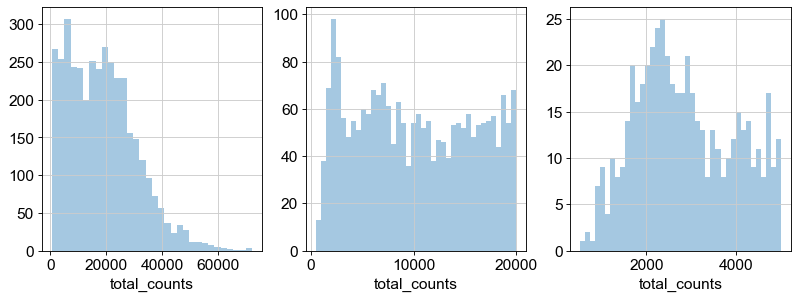

In [22]:
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["total_counts"][adata.obs["total_counts"] < 20000], kde=False, bins=40, ax=axs[1])
sns.distplot(adata.obs["total_counts"][adata.obs["total_counts"] < 5000], kde=False, bins=40, ax=axs[2])

For total_counts a lower cutoff of 3500 seems reasonable to me.  
I decided against an uppper limit.

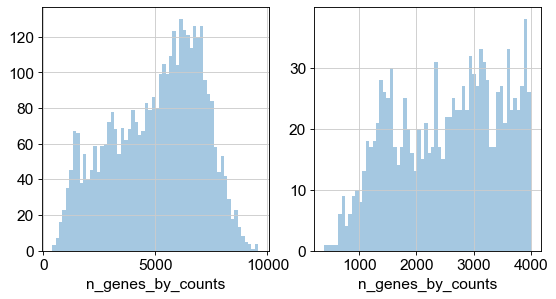

In [23]:
fig, axs = plt.subplots(1, 2, figsize=(8, 4))
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[0])
sns.distplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[1])

For n_genes_by_counts a lower cutoff of 1000 seems reasonable to me.

... storing 'feature_types' as categorical
... storing 'genome' as categorical


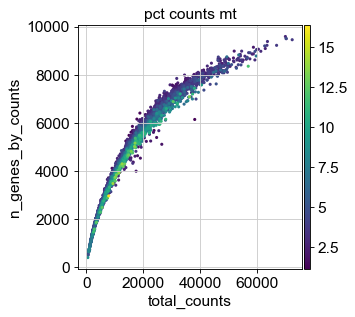

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


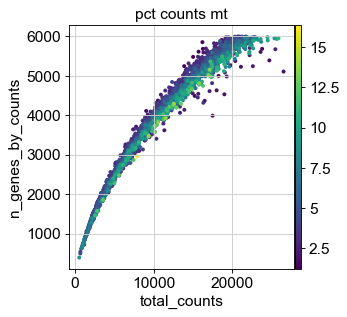

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


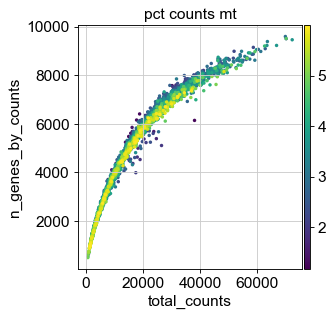

In [24]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')
sc.pl.scatter(adata[adata.obs["n_genes_by_counts"] < 6000], 
              x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')
sc.pl.scatter(adata[adata.obs["pct_counts_mt"] < 6], x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')

The fraction of mt-rna does not seem to be a very good marker to filter on genes. Why? Is this distinct to spatial transcriptomics data?

In fact it seems as if there was a mt-high and a mt-low population that is distributed equally along the total_counts and n_genes_by_counts values.

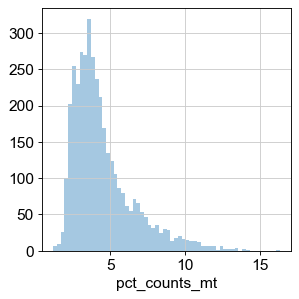

In [25]:
sns.distplot(adata.obs["pct_counts_mt"], kde=False, bins=60)

The feeling of 2 distinct mt-subpopulation has not been confirmed by the histogram.

In [26]:
sc.pp.filter_cells(adata, min_counts=3500)
# sc.pp.filter_cells(adata, max_counts=40000) # I decided against using an upper limit
# adata = adata[adata.obs["pct_counts_mt"] < 20] # I decided against using mt as a selector
print(f"#cells after MT filter: {adata.n_obs}")
sc.pp.filter_genes(adata, min_cells=10)

filtered out 361 cells that have less than 3500 counts
/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


#cells after MT filter: 3452


filtered out 15067 genes that are detected in less than 10 cells
/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [27]:
adata

AnnData object with n_obs × n_vars = 3452 × 18471
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

This spot filtering was very unrestrictive and we reduced the number of cells/spots only minimally. However, we drastically reduced the number of genes by only using genes, that are expressed in at least 10 spots. Therefore, we limit out detection limit so that we can detect only clusters of at least 10 spots. 

We proceed to normalize Visium counts data with the built-in normalize_total method from Scanpy, and detect highly-variable genes (for later). Note that there are alternatives for normalization (see discussion in [Luecken19], and more recent alternatives such as SCTransform or GLM-PCA).

In [28]:
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000)

normalizing counts per cell
    finished (0:00:00)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


normalizing counts per cell
    finished (0:00:00)


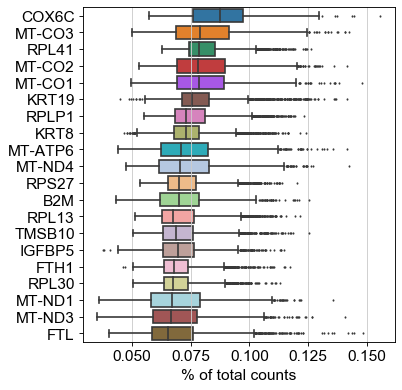

In [29]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Mitochondrial RNA seems to make up a large fraction of all counts over all spots.  
Comment by Giovanni: this is a common phenomenon. Mitochondrial genes are commonly expressed at very high levels!

### Manifold embedding and clustering based on transcriptional similarity


In [30]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters")

computing PCA
    on highly variable genes
/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
running Leiden clustering
    finished: found 14 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:01)


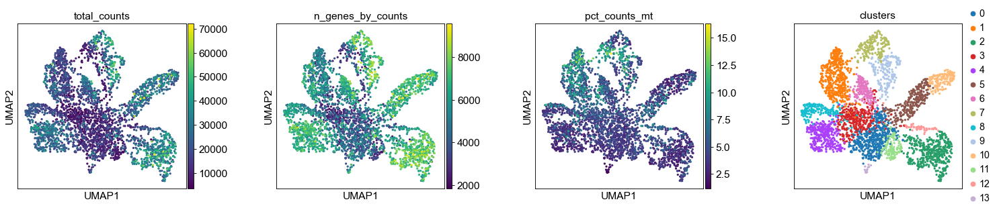

In [31]:
plt.rcParams["figure.figsize"] = (4, 4)
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts", "pct_counts_mt", "clusters"], wspace=0.4)

There is a striking clustering of spots with low total_counts and low n_genes_by_counts that are mainly attributed to cluster 3 and 0. These might be technical artefacts, however I decided to keep them primarily in the analysis to later check if those spots map to regions without viable tissue on the histo image.

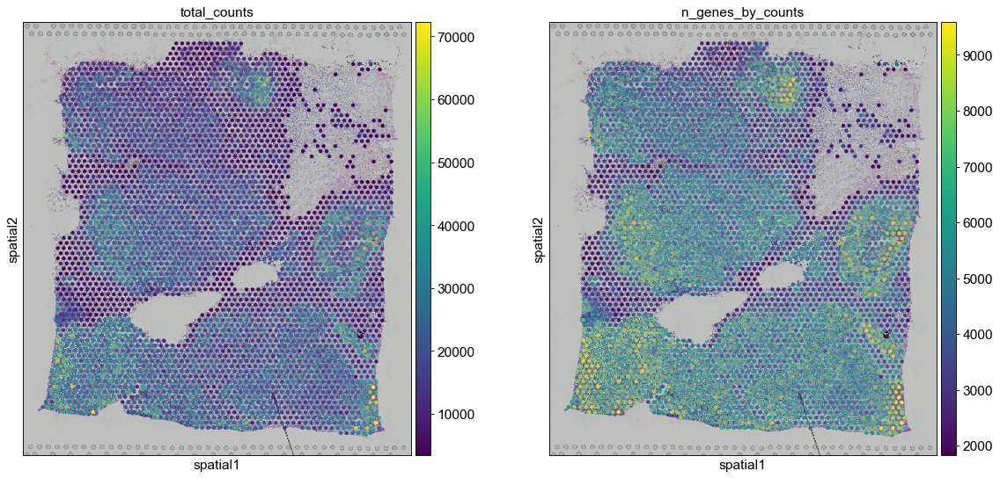

In [32]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["total_counts", "n_genes_by_counts"])

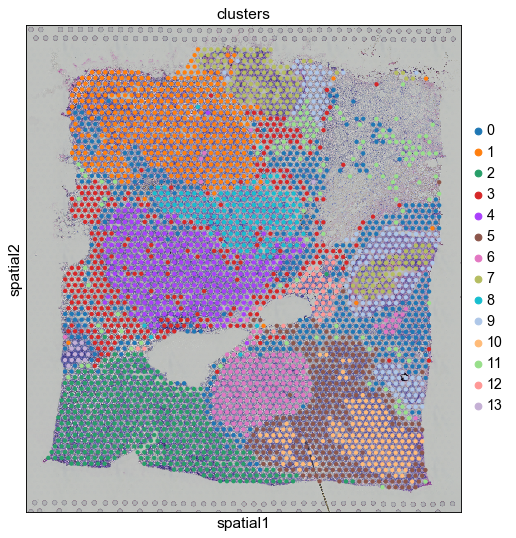

In [33]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["clusters"])

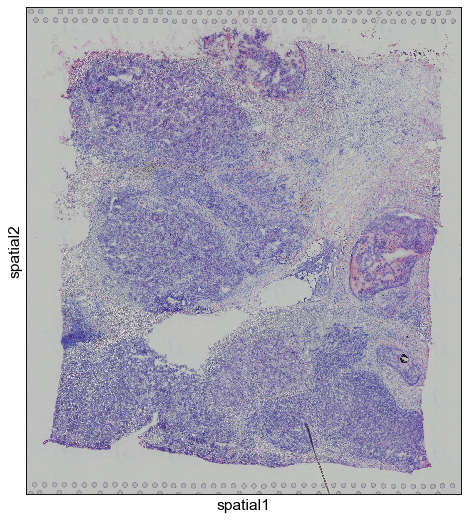

In [34]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", alpha = 0)

As expected the clusters 0 and 3 map onto regions of the histo slides with very low cellularity. These regions are mainly composed of fibrous tissue (personal histo-morphological assessemnt of the tif image). Fibrous tissue is rich in extracellular matrix and low in cellularity. This explains the low counts.

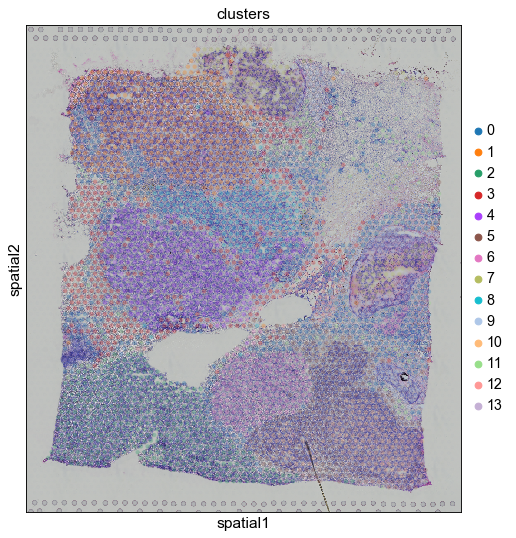

In [35]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["clusters"], alpha = 0.3)

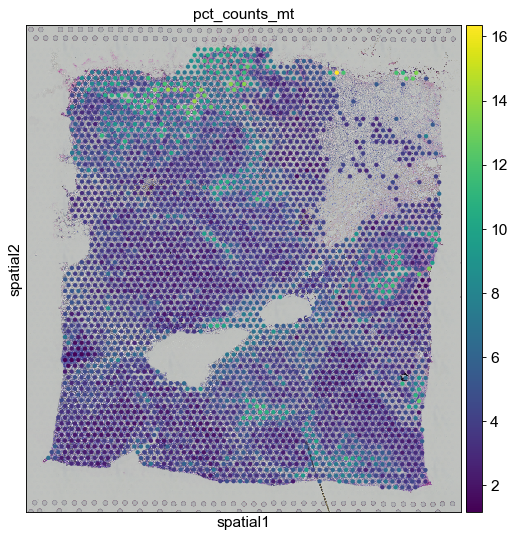

In [36]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["pct_counts_mt"])

### Identify cluster Marker Genes


In [37]:
sc.tl.rank_genes_groups(adata, "clusters", method="t-test")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


In [38]:
# overview of markergenes
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,C3,COX6C,CXCL14,APOE,CPB1,CRISP3,S100G,MGP,PVALB,MGP,CRISP3,IGFBP7,RPLP1,CORO1A
1,TIMP1,SLC39A6,CCND1,APOC1,COX6C,SLITRK6,IFI6,S100G,MUC5B,S100A6,SLITRK6,VIM,RPL8,CD52
2,CD74,SNCG,GFRA1,CD74,IL6ST,S100A11,IFI27,CSTA,LINC00645,GAPDH,IGFBP5,TIMP1,RPS27,TRBC2
3,VIM,WFDC2,S100A11,C1QA,HLA-B,S100A13,HLA-B,DSP,ZNF703,DSP,H3F3A,FLNA,CXCL14,TXNIP
4,CYBA,MT-ND1,TTLL12,FTL,TNFSF10,IGFBP5,AC087379.2,ZNF703,EXOC2,TFF1,VTCN1,ENG,S100A11,CCL19
5,IGHG1,RAB11FIP1,TCEAL4,IGKC,HLA-C,S100A16,HLA-A,KAT6B,BAMBI,KRT14,S100A13,SPARC,CPNE7,LSP1
6,COL6A2,CSTA,AGR2,KRT19,TBC1D9,CALML5,HEBP1,TFF3,IGFBP5,S100G,SERHL2,A2M,RPL7,RPLP2
7,C1QA,MT-CO1,KRT8,IGHG1,SLC9A3R1,SERHL2,IFT122,RAB11FIP1,IGFBP2,TFF3,PPIA,SPARCL1,SH3BGRL,RPS12
8,HLA-DRA,UGCG,MUC1,ADIRF,ERLIN2,C6orf141,ISG15,STC2,SLC39A6,RPS18,S100A16,CAVIN1,SHISA2,RPS25
9,IGKC,MCCD1,GNG5,CALML5,ADIRF,ELF3,LGALS3BP,RERG,COLEC12,LDHA,EFHD1,HSPG2,RPL39,TBC1D10C


**cluster annotation:**  
Cluster 0 - CD74 (part of MHC2), C3 (part of complement system), TIMP1 (metallopeptidase inhibitor), VIM (vimentin, cytosceleton), HLA-DRA (MHC2), CYBA (phagocytes) --> antigen presentation, immune reaction

#### Group 0

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters']`
categories: 0, 1, 2, etc.
var_group_labels: 0


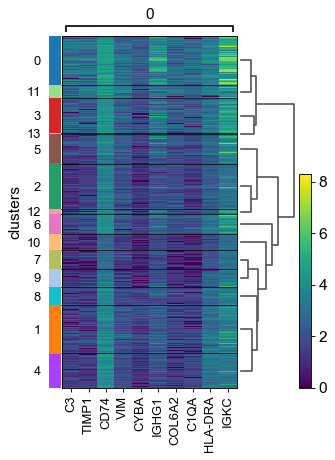

In [39]:
sc.pl.rank_genes_groups_heatmap(adata, groups="0", n_genes=10, groupby="clusters")

#### Group 1

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
categories: 0, 1, 2, etc.
var_group_labels: 1


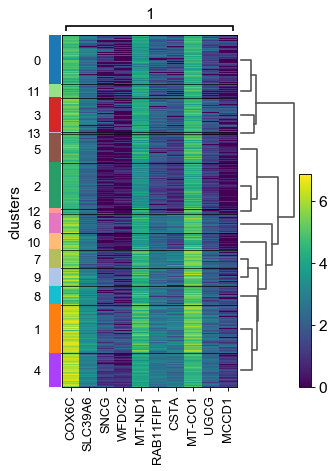

In [40]:
sc.pl.rank_genes_groups_heatmap(adata, groups="1", n_genes=10, groupby="clusters")

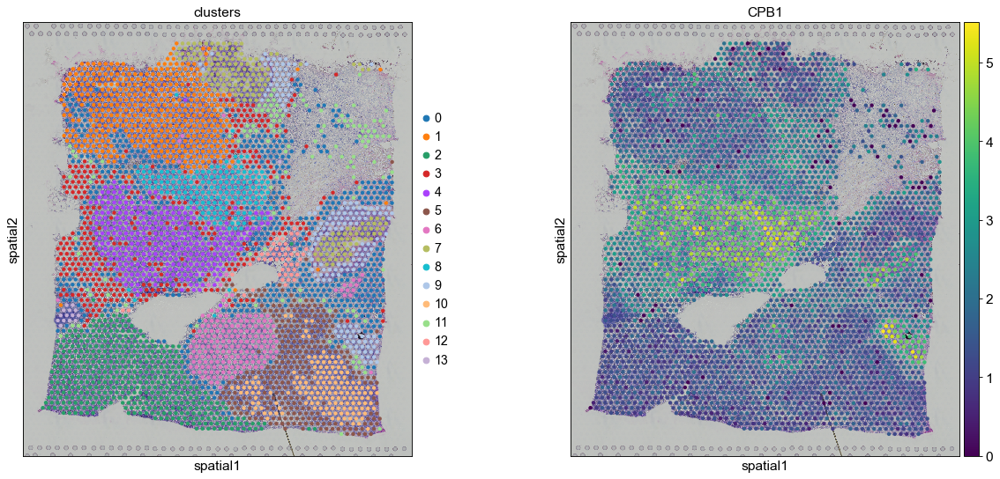

In [41]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "CPB1"])

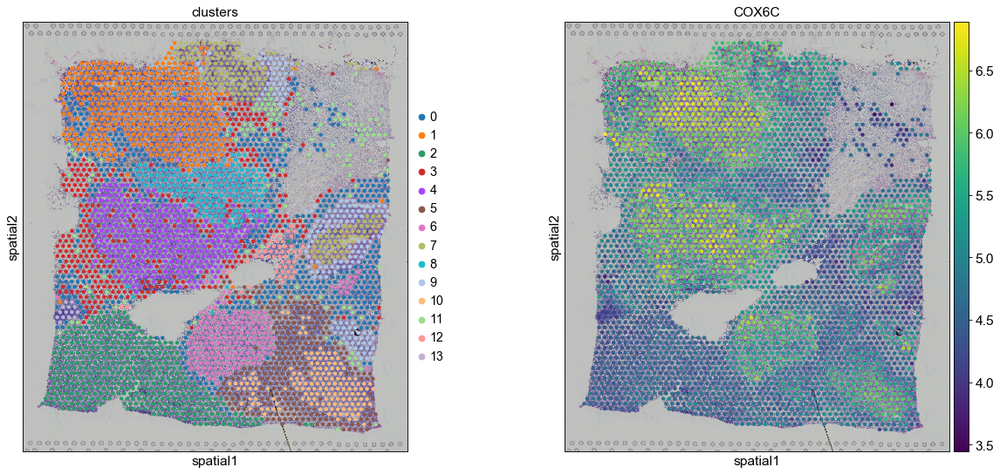

In [42]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "COX6C"])

#### Group 3 

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
categories: 0, 1, 2, etc.
var_group_labels: 3


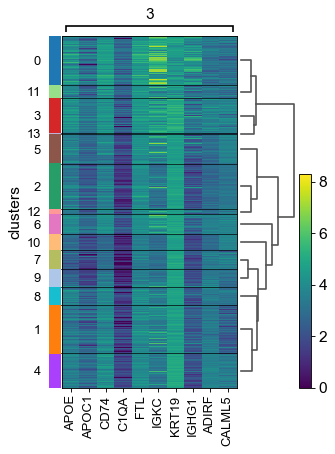

In [43]:
sc.pl.rank_genes_groups_heatmap(adata, groups="3", n_genes=10, groupby="clusters")

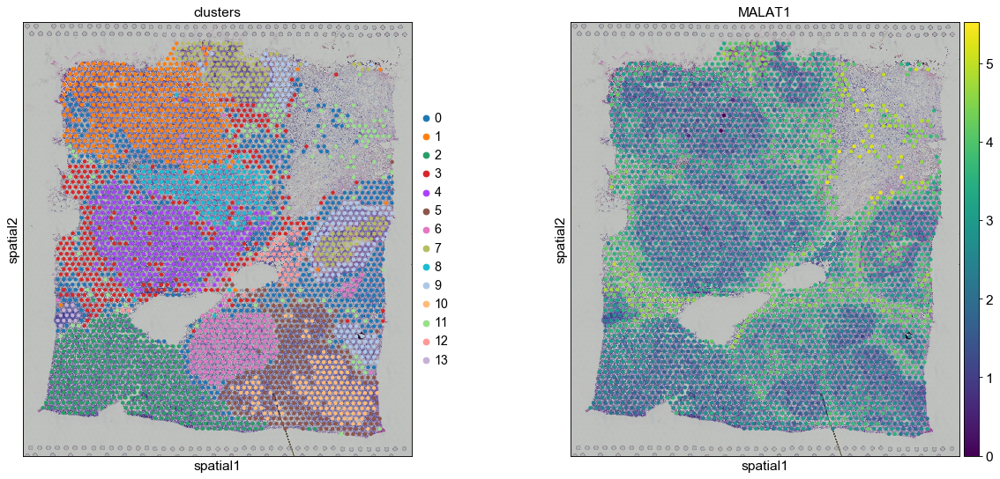

In [44]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "MALAT1"])

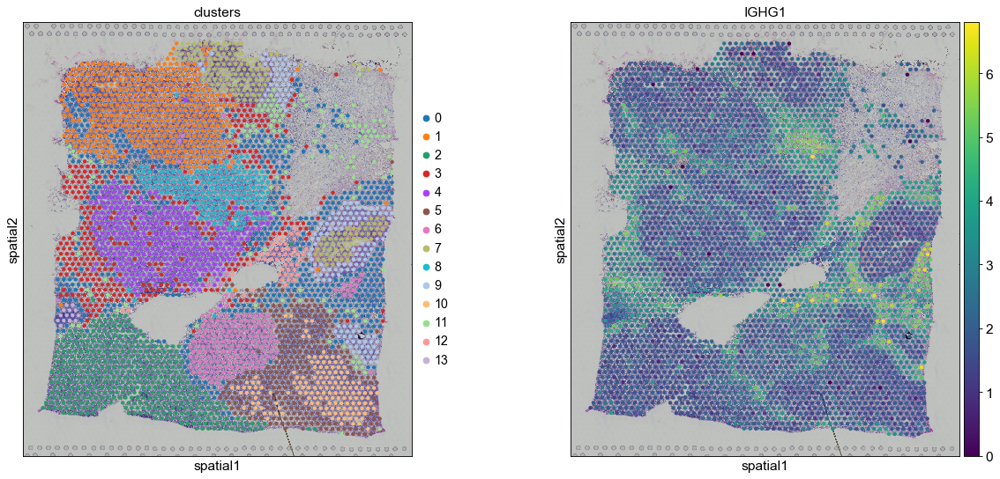

In [45]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "IGHG1"])

According to 10X genomics the tumor cells are ER positvie, PR negative and Her2 (ERBB2) positive. Those 3 markers are commonly used for clinical decision making. Let's inspect their transcriptional expression levels.

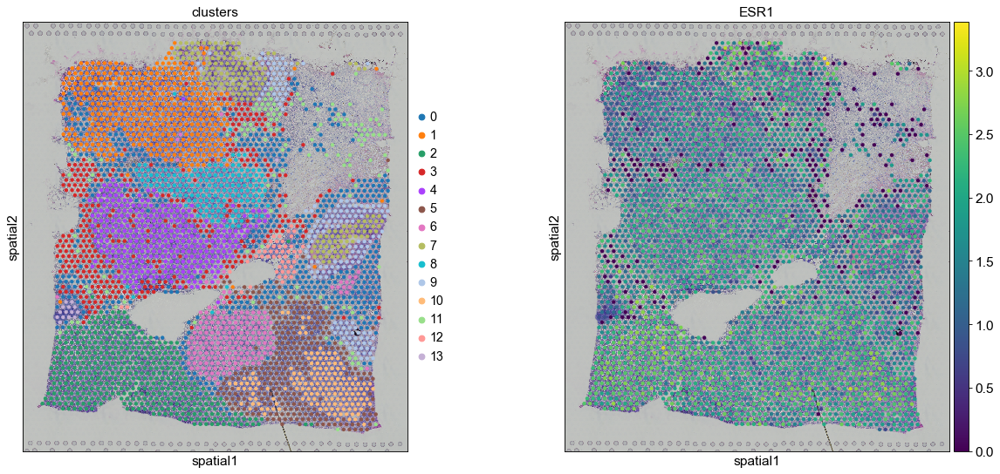

In [46]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "ESR1"])

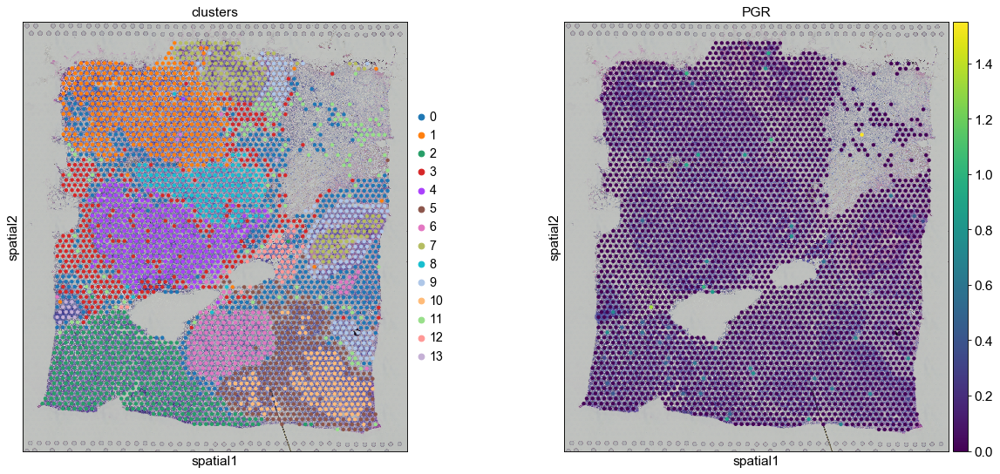

In [47]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "PGR"])

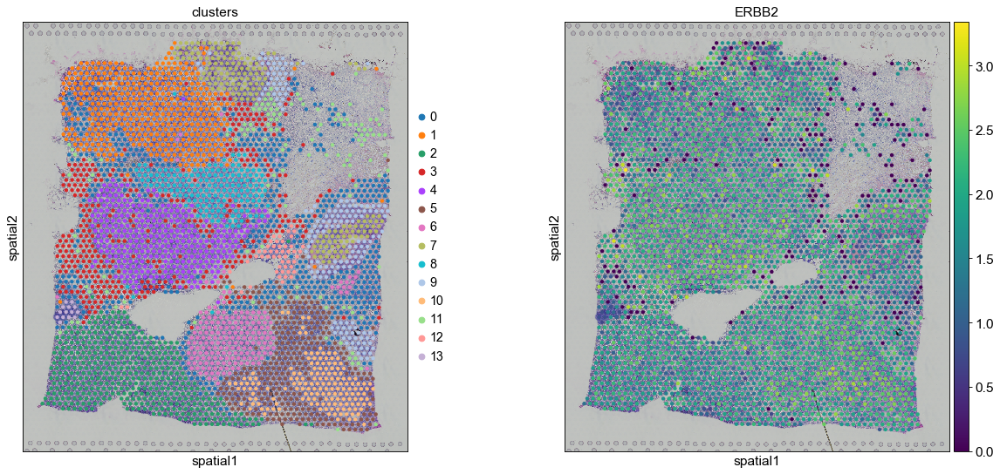

In [48]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "ERBB2"])

In fact we could observe the immunohistochemical features also on the transcriptional level. Awsome!

### Assess signs of T cell activity.

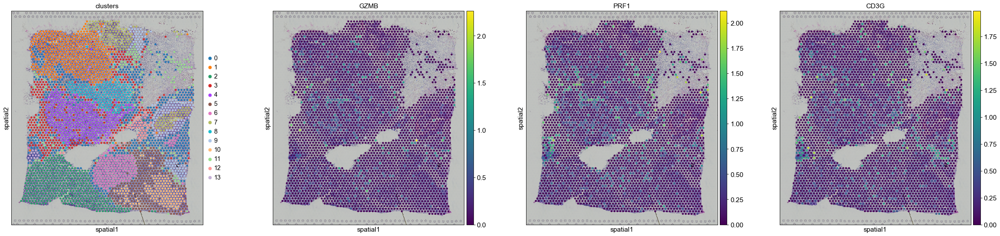

In [49]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "GZMB", "PRF1", "CD3G"])

The CD3 gene is a common marker for T cells. T cells attack tumor cells by secreting Granzyme B (GZMB) and Perforin (PRF1) which creates holes in the tumor cells surface and subsequently kills them. Here, we observe very dim and rather homogeneous distribution. The co-localization of all three markers indicate activated T cell defence angainst the tumor (cytolytic activity).

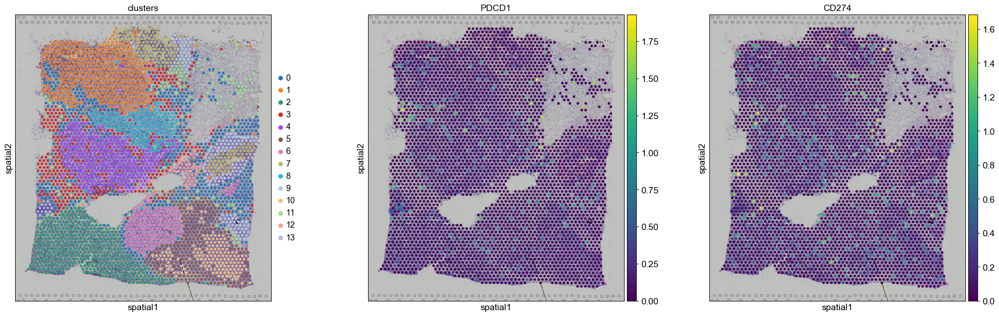

In [50]:
sc.pl.spatial(adata, img_key="hires", color=["clusters", "PDCD1", "CD274"])

PDCD1 = PD1  
CD274 = PD1-Ligand

### Play around with Squidpy


In [60]:
adata.raw = adata
sq.gr.ligrec(adata, cluster_key="clusters", use_raw=False)

Fetching interactions from `omnipath`
/opt/anaconda3/lib/python3.7/site-packages/omnipath/_core/requests/_utils.py:155: FutureWarning: The default value of regex will change from True to False in a future version.
  _split_unique_join(data.str.replace(r"[-\w]*:?(\d+)", r"\1")), func=func
Fetched `8919` interactions
    Finish (0:00:03)
Running `1000` permutations on `2074` interactions and `196` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Adding `adata.uns['clusters_ligrec']`
Finish (0:00:22)


In [63]:
adata

AnnData object with n_obs × n_vars = 3452 × 18471
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'clusters_colors', 'rank_genes_groups', 'dendrogram_clusters', 'clusters_ligrec'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [65]:
adata.uns['clusters_ligrec'][0]

cluster_1               0                                                    \
cluster_2               0         1        10        11        12        13   
source  target                                                                
FYN     TRPV4    0.241491  0.225060  0.231935  0.236465  0.224537  0.000000   
        TRPV6    0.244576  0.229629  0.245067  0.227108  0.329207  0.000000   
KL      TRPV6    0.032888  0.017941  0.033378  0.015419  0.117519  0.000000   
S100A10 TRPV6    0.866461  0.851514  0.866952  0.848993  0.951093  0.000000   
RGS2    TRPV6    0.135610  0.120663  0.136101  0.118142  0.220241  0.000000   
...                   ...       ...       ...       ...       ...       ...   
NECTIN4 TIGIT    0.275957  0.168290  0.138175  0.210234  0.131925  0.596029   
FSTL1   DIP2A    0.801229  0.792736  0.827636  0.780015  0.778930  0.957763   
TOR2A   ATP5F1B  1.075711  1.379781  1.312820  1.070174  1.196036  1.148149   
TH      DRD1     0.002399  0.007559  0.002642  0.000000  0.014556  0.000000   
ACP6    HEXIM1   0.456986  0.678460  0.761484  0.420513  0.581672  0.523576   

cluster_1                                                ...         9  \
cluster_2               2         3         4         5  ...        12   
source  target                                           ...             
FYN     TRPV4    0.235722  0.232651  0.229723  0.231064  ...  0.044426   
        TRPV6    0.262876  0.231192  0.230758  0.241625  ...  0.149096   
KL      TRPV6    0.051188  0.019504  0.019070  0.029937  ...  0.113149   
S100A10 TRPV6    0.884761  0.853077  0.852643  0.863510  ...  1.043599   
RGS2    TRPV6    0.153910  0.122226  0.121792  0.132659  ...  0.185186   
...                   ...       ...       ...       ...  ...       ...   
NECTIN4 TIGIT    0.144535  0.173231  0.182828  0.148783  ...  0.290552   
FSTL1   DIP2A    0.808818  0.756179  0.788640  0.799314  ...  0.333892   
TOR2A   ATP5F1B  1.364678  1.074050  1.310499  1.208604  ...  1.174138   
TH      DRD1     0.006274  0.006567  0.017611  0.001659  ...  0.025575   
ACP6    HEXIM1   0.614613  0.523624  0.695276  0.616729  ...  0.652855   

cluster_1                                                                    \
cluster_2              13         2         3         4         5         6   
source  target                                                                
FYN     TRPV4    0.000000  0.055610  0.052540  0.049612  0.050953  0.049375   
        TRPV6    0.000000  0.082765  0.051081  0.050647  0.061514  0.059536   
KL      TRPV6    0.000000  0.046818  0.015134  0.014700  0.025567  0.023589   
S100A10 TRPV6    0.000000  0.977268  0.945584  0.945150  0.956017  0.954039   
RGS2    TRPV6    0.000000  0.118855  0.087171  0.086737  0.097604  0.095626   
...                   ...       ...       ...       ...       ...       ...   
NECTIN4 TIGIT    0.754657  0.303162  0.331858  0.341455  0.307410  0.338107   
FSTL1   DIP2A    0.512725  0.363781  0.311142  0.343602  0.354276  0.320614   
TOR2A   ATP5F1B  1.126252  1.342781  1.052153  1.288602  1.186707  1.280653   
TH      DRD1     0.000000  0.017292  0.017585  0.028630  0.012678  0.000000   
ACP6    HEXIM1   0.594759  0.685795  0.594807  0.766459  0.687912  0.773761   

cluster_1                                      
cluster_2               7         8         9  
source  target                                 
FYN     TRPV4    0.044084  0.050202  0.047452  
        TRPV6    0.052872  0.056445  0.072084  
KL      TRPV6    0.016926  0.020499  0.036137  
S100A10 TRPV6    0.947376  0.950948  0.966587  
RGS2    TRPV6    0.088963  0.092536  0.108174  
...                   ...       ...       ...  
NECTIN4 TIGIT    0.287383  0.304158  0.293967  
FSTL1   DIP2A    0.317213  0.337761  0.324956  
TOR2A   ATP5F1B  1.310076  1.249946  1.236887  
TH      DRD1     0.000000  0.020857  0.020212  
ACP6    HEXIM1   0.830106  0.757172  0.812600  

[2074 rows x 196 columns]

In [70]:
# visualization
sq.pl.ligrec(
    adata,
    cluster_key="clusters",
    alpha = 0.0001,
)

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


<function squidpy.pl._ligrec.ligrec(adata: Union[anndata._core.anndata.AnnData, squidpy.gr._ligrec.LigrecResult], cluster_key: Union[str, NoneType] = None, source_groups: Union[str, Sequence[str], NoneType] = None, target_groups: Union[str, Sequence[str], NoneType] = None, means_range: Tuple[float, float] = (-inf, inf), pvalue_threshold: float = 1.0, remove_empty_interactions: bool = True, dendrogram: Union[str, NoneType] = None, alpha: Union[float, NoneType] = 0.001, swap_axes: bool = False, title: Union[str, NoneType] = None, figsize: Union[Tuple[float, float], NoneType] = None, dpi: Union[int, NoneType] = None, save: Union[str, pathlib.Path, NoneType] = None, **kwargs: Any) -> None>